In [102]:
import pandas as pd
import pandas_profiling
from datetime import date
import seaborn as sns
import matplotlib.pyplot as plt
plt.rc('font',family='AppleGothic', size=25)
plt.rc('axes', unicode_minus=False)

In [34]:
df=pd.read_excel("data/subway2019.xlsx")
df.head()

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,...,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,(단위:명)
0,날짜,호선,역번호,역명,구분,06시 이전,06 ~ 07,07 ~ 08,08 ~ 09,09 ~ 10,...,16 ~ 17,17 ~ 18,18 ~ 19,19 ~ 20,20 ~ 21,21 ~ 22,22 ~ 23,23 ~ 24,24시 이후,합 계
1,2019-01-01 00:00:00,1호선,150,서울역,승차,348,321,348,741,940,...,3226,3447,3277,2898,2590,3004,2234,970,38,39559
2,2019-01-01 00:00:00,1호선,150,서울역,하차,222,821,808,961,1472,...,2491,2572,2060,1991,1683,1217,764,456,149,31279
3,2019-01-01 00:00:00,1호선,151,시청,승차,87,98,143,206,280,...,958,1062,1146,1119,992,904,570,211,6,11836
4,2019-01-01 00:00:00,1호선,151,시청,하차,48,237,323,571,577,...,733,746,606,374,311,268,177,144,57,10359


In [35]:
df.columns = list(df.iloc[0])

In [36]:
df=df.drop(index=0)

In [37]:
df

,날짜,호선,역번호,역명,구분,06시 이전,06 ~ 07,07 ~ 08,08 ~ 09,09 ~ 10,...,16 ~ 17,17 ~ 18,18 ~ 19,19 ~ 20,20 ~ 21,21 ~ 22,22 ~ 23,23 ~ 24,24시 이후,합 계
1,2019-01-01 00:00:00,1호선,150,서울역,승차,348,321,348,741,940,...,3226,3447,3277,2898,2590,3004,2234,970,38,39559
2,2019-01-01 00:00:00,1호선,150,서울역,하차,222,821,808,961,1472,...,2491,2572,2060,1991,1683,1217,764,456,149,31279
3,2019-01-01 00:00:00,1호선,151,시청,승차,87,98,143,206,280,...,958,1062,1146,1119,992,904,570,211,6,11836
4,2019-01-01 00:00:00,1호선,151,시청,하차,48,237,323,571,577,...,733,746,606,374,311,268,177,144,57,10359
5,2019-01-01 00:00:00,1호선,152,종각,승차,669,318,217,203,333,...,1870,2129,2024,1806,1796,1780,1296,497,31,21042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200800,2019-12-31 00:00:00,8호선,2825,신흥,하차,20,87,86,243,208,...,501,510,562,493,378,301,257,154,163,5794
200801,2019-12-31 00:00:00,8호선,2826,수진,승차,111,224,542,813,436,...,427,436,395,245,219,155,126,68,82,6228
200802,2019-12-31 00:00:00,8호선,2826,수진,하차,27,97,115,433,259,...,373,463,501,452,354,332,322,256,163,5996
200803,2019-12-31 00:00:00,8호선,2827,모란,승차,73,95,342,482,253,...,366,375,418,242,199,152,189,126,65,5151


## EDA 

In [38]:
profile = df.profile_report()
profile

In [39]:
df.columns

Index(['날짜', '호선', '역번호', '역명', '구분', '06시 이전', '06 ~ 07', '07 ~ 08',
       '08 ~ 09', '09 ~ 10', '10 ~ 11', '11 ~ 12', '12 ~ 13', '13 ~ 14',
       '14 ~ 15', '15 ~ 16', '16 ~ 17', '17 ~ 18', '18 ~ 19', '19 ~ 20',
       '20 ~ 21', '21 ~ 22', '22 ~ 23', '23 ~ 24', '24시 이후', '합 계'],
      dtype='object')

## 주말데이터 제외하기

In [68]:
df['요일']=df['날짜'].apply(lambda x:x.strftime('%A'))

In [69]:
df[['날짜','요일']]

,날짜,요일
1,2019-01-01 00:00:00,Tuesday
2,2019-01-01 00:00:00,Tuesday
3,2019-01-01 00:00:00,Tuesday
4,2019-01-01 00:00:00,Tuesday
5,2019-01-01 00:00:00,Tuesday
...,...,...
200800,2019-12-31 00:00:00,Tuesday
200801,2019-12-31 00:00:00,Tuesday
200802,2019-12-31 00:00:00,Tuesday
200803,2019-12-31 00:00:00,Tuesday


In [70]:
df['요일'].unique()

array(['Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday',
       'Monday'], dtype=object)

In [74]:
weekend = ['Sunday','Saturday']
weekday=df[~df['요일'].isin(weekend)]

## 출근시간, 퇴근시간 구분하기

In [79]:
df2=weekday[weekday['구분'] == '하차']
df3=weekday[weekday['구분'] == '승차']

#출근 - 하차 시각 7시 ~ 11시 
gotowork=df2[['날짜','요일','호선','역번호','역명','구분','07 ~ 08','08 ~ 09','09 ~ 10','10 ~ 11']]
#퇴근 - 승차 시각 5시 ~ 8시
offwork=df3[['날짜','요일','호선','역번호','역명','구분','17 ~ 18', '18 ~ 19', '19 ~ 20']]

print(gotowork.shape)
print(offwork.shape)

(71794, 10)
(71794, 9)


## 출근시간 분석

### 1) 어떤 역이 유동인구가 많을까
- 출근 집중시간 8시 ~ 10시 로 줄여볼까

In [81]:
gotowork.groupby(['역명','요일'])['07 ~ 08'].sum().unstack(level=1)

요일,Friday,Monday,Thursday,Tuesday,Wednesday
역명,,,,,
가락시장,48504,54350,49495,52431,48849
가산디지털단지,216802,255340,217124,238977,220314
강남,365546,402113,369993,401070,381358
강남구청,61945,69041,62755,68106,64476
강동,52358,60231,55281,59543,56284
...,...,...,...,...,...
홍제,25566,26224,25256,26449,24990
화곡,28990,30502,28762,31122,29659
화랑대(서울여대입구),15805,16750,16064,17619,15972


In [105]:
goto7_8=gotowork.groupby(['역명'])['07 ~ 08'].sum().sort_values(ascending=False).head(30)
goto7_8

역명
강남              1920080
서울역             1534037
여의도             1509093
시청              1506155
역삼              1454767
삼성(무역센터)        1424736
을지로입구           1395772
잠실(송파구청)        1272363
선릉              1241064
안국              1175051
양재(서초구청)        1164221
가산디지털단지         1148557
종각              1137485
을지로3가           1096864
광화문(세종문화회관)      990658
고속터미널            963797
교대(법원.검찰청)       931857
사당               851189
구로디지털단지          832689
성수               742108
공덕               725438
동대문역사문화공원        712124
청담               664364
남부터미널(예술의전당)     652827
종로3가             636128
서대문              625474
회현(남대문시장)        607030
충무로              595989
합정               582308
동대문              571276
Name: 07 ~ 08, dtype: int64

<AxesSubplot:xlabel='역명'>

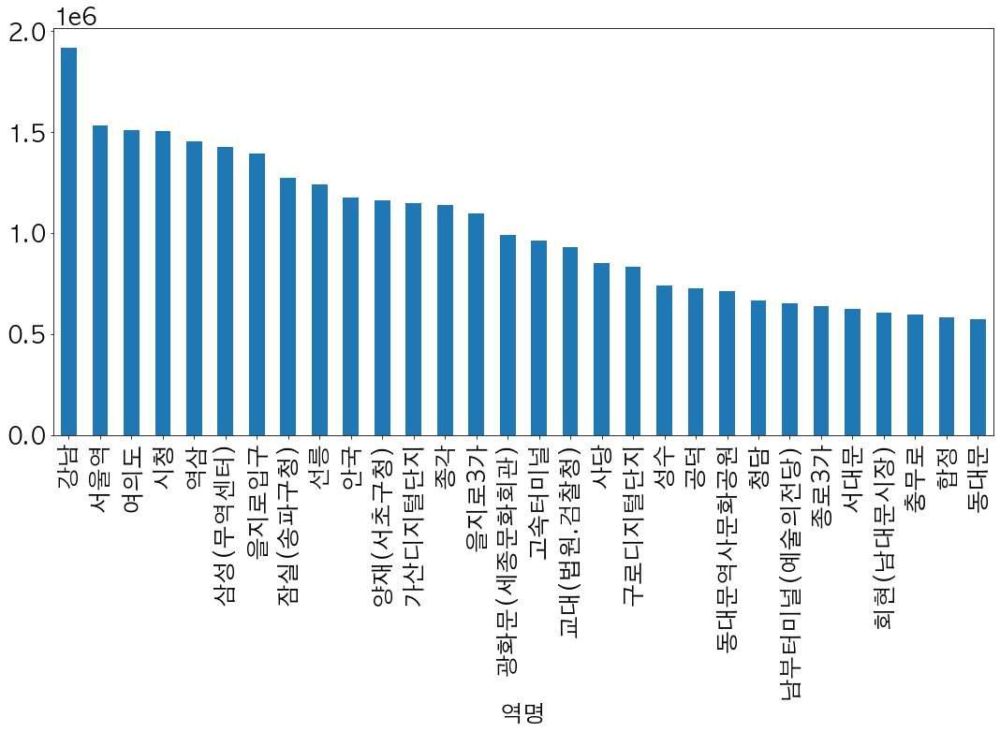

In [106]:
goto7_8.plot.bar(figsize=(18,8))

<AxesSubplot:xlabel='역명'>

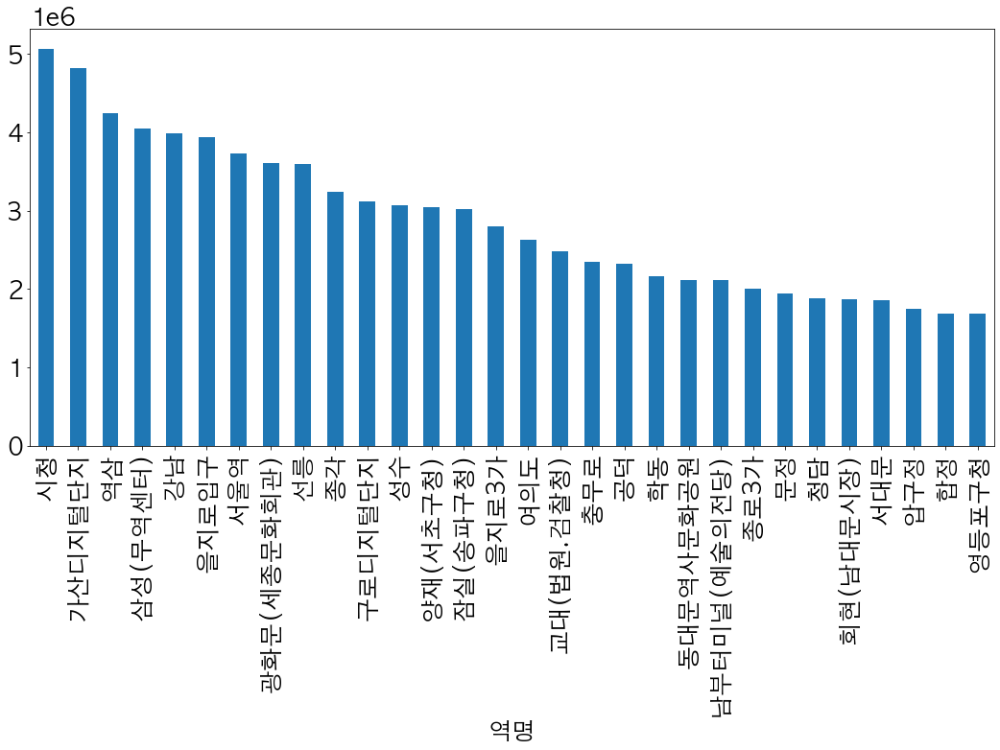

In [104]:
gotowork.groupby(['역명'])['08 ~ 09'].sum().sort_values(ascending=False).head(30).plot.bar(figsize=(18,8))

<AxesSubplot:xlabel='역명'>

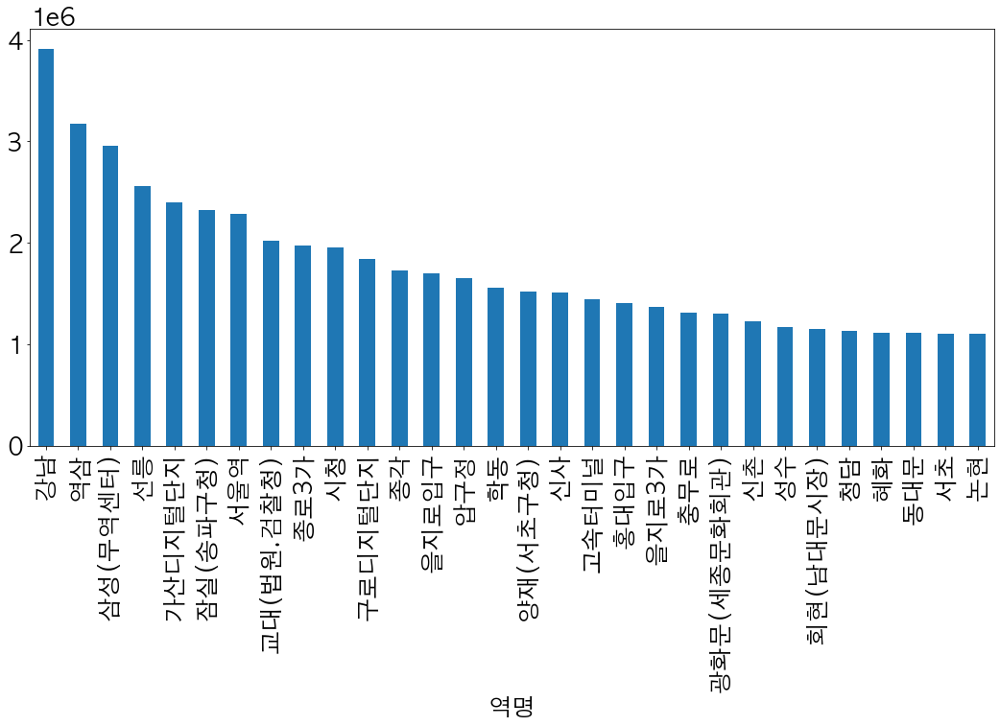

In [107]:
gotowork.groupby(['역명'])['09 ~ 10'].sum().sort_values(ascending=False).head(30).plot.bar(figsize=(18,8))

<AxesSubplot:xlabel='역명'>

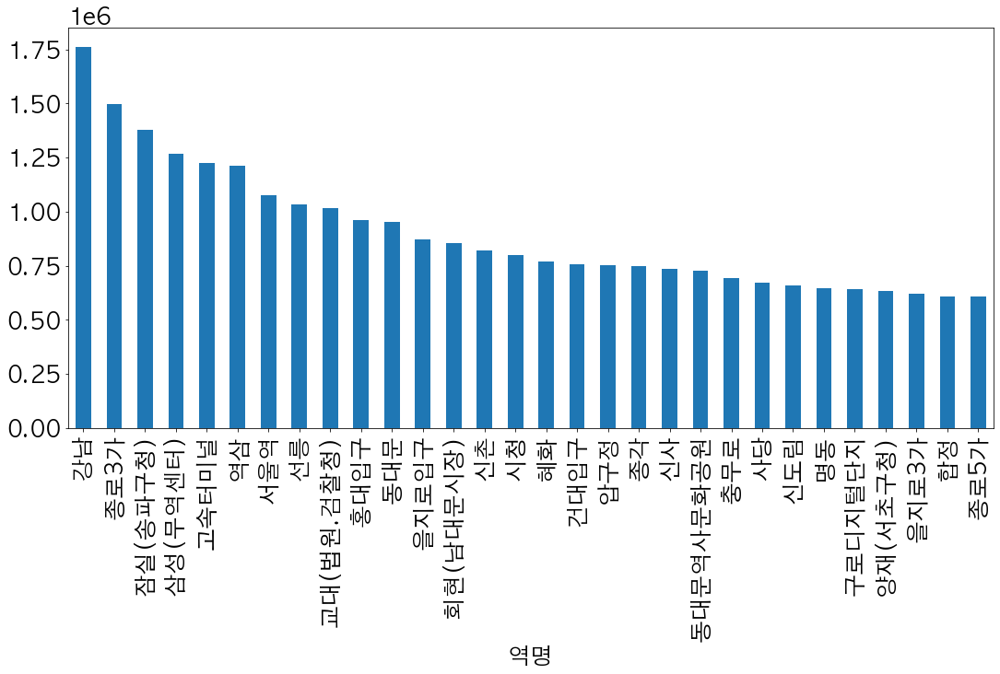

In [108]:
gotowork.groupby(['역명'])['10 ~ 11'].sum().sort_values(ascending=False).head(30).plot.bar(figsize=(18,8))

### 2) 주요 역의 월별 변화량

- 강남역

In [110]:
강남=gotowork[gotowork['역명'] == '강남']

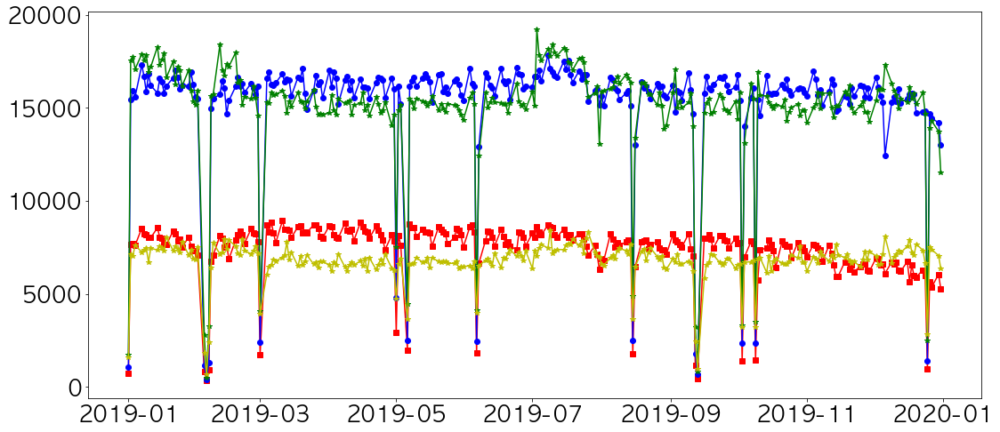

In [116]:
plt.figure(figsize=(18,8))
plt.plot(강남.날짜, 강남['07 ~ 08'], marker='s', color='r')
plt.plot(강남.날짜, 강남['08 ~ 09'], marker='o', color='b')
plt.plot(강남.날짜, 강남['09 ~ 10'], marker='*', color='g')
plt.plot(강남.날짜, 강남['10 ~ 11'], marker='*', color='y')